<a href="https://colab.research.google.com/github/vinnik-dmitry07/furniture-generation/blob/main/DreamBooth_Stable_Diffusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%load_ext tensorboard

In [ ]:
#@markdown Check type of GPU and VRAM available.
!nvidia-smi --query-gpu=name,memory.total,memory.free --format=csv,noheader

NVIDIA A100-SXM4-40GB, 40960 MiB, 40513 MiB


https://github.com/ShivamShrirao/diffusers/tree/main/examples/dreambooth

In [ ]:
# Download dataset from kaggle is much faster
from google.colab import files
files.upload()
!mkdir /root/.kaggle
!mv kaggle.json /root/.kaggle/kaggle.json
!kaggle datasets download -d dmitryvinnik/furniture
!unzip -q furniture.zip -d ./furniture

Saving kaggle.json to kaggle.json
 95% 507M/531M [00:06<00:00, 110MB/s] 
100% 531M/531M [00:06<00:00, 80.2MB/s]


## Install Requirements

In [ ]:
!wget -q https://github.com/ShivamShrirao/diffusers/raw/main/examples/dreambooth/train_dreambooth.py
!wget -q https://github.com/ShivamShrirao/diffusers/raw/main/scripts/convert_diffusers_to_original_stable_diffusion.py
%pip install -qq git+https://github.com/ShivamShrirao/diffusers
%pip install -q -U --pre triton
%pip install -q accelerate transformers ftfy bitsandbytes==0.35.0 gradio natsort safetensors xformers torchmetrics[image]

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
#@title Login to HuggingFace 🤗

#@markdown You need to accept the model license before downloading or using the Stable Diffusion weights. Please, visit the [model card](https://huggingface.co/runwayml/stable-diffusion-v1-5), read the license and tick the checkbox if you agree. You have to be a registered user in 🤗 Hugging Face Hub, and you'll also need to use an access token for the code to work.
# https://huggingface.co/settings/tokens
!mkdir -p ~/.huggingface
HUGGINGFACE_TOKEN = "" #@param {type:"string"}
!echo -n "{HUGGINGFACE_TOKEN}" > ~/.huggingface/token

## Settings and run

In [ ]:
#@markdown If model weights should be saved directly in google drive (takes around 4-5 GB).
save_to_gdrive = False #@param {type:"boolean"}
if save_to_gdrive:
    from google.colab import drive
    drive.mount('/content/drive')

#@markdown Name/Path of the initial model.
MODEL_NAME = "stabilityai/stable-diffusion-2-1" #@param {type:"string"}

#@markdown Enter the directory name to save model at.

OUTPUT_DIR = "stable_diffusion_weights/zwx" #@param {type:"string"}
if save_to_gdrive:
    OUTPUT_DIR = "/content/drive/MyDrive/" + OUTPUT_DIR
else:
    OUTPUT_DIR = "/content/" + OUTPUT_DIR

print(f"[*] Weights will be saved at {OUTPUT_DIR}")

!mkdir -p $OUTPUT_DIR

[*] Weights will be saved at /content/stable_diffusion_weights/zwx


# Start Training

Use the table below to choose the best flags based on your memory and speed requirements. Tested on Tesla T4 GPU.


| `fp16` | `train_batch_size` | `gradient_accumulation_steps` | `gradient_checkpointing` | `use_8bit_adam` | GB VRAM usage | Speed (it/s) |
| ---- | ------------------ | ----------------------------- | ----------------------- | --------------- | ---------- | ------------ |
| fp16 | 1                  | 1                             | TRUE                    | TRUE            | 9.92       | 0.93         |
| no   | 1                  | 1                             | TRUE                    | TRUE            | 10.08      | 0.42         |
| fp16 | 2                  | 1                             | TRUE                    | TRUE            | 10.4       | 0.66         |
| fp16 | 1                  | 1                             | FALSE                   | TRUE            | 11.17      | 1.14         |
| no   | 1                  | 1                             | FALSE                   | TRUE            | 11.17      | 0.49         |
| fp16 | 1                  | 2                             | TRUE                    | TRUE            | 11.56      | 1            |
| fp16 | 2                  | 1                             | FALSE                   | TRUE            | 13.67      | 0.82         |
| fp16 | 1                  | 2                             | FALSE                   | TRUE            | 13.7       | 0.83          |
| fp16 | 1                  | 1                             | TRUE                    | FALSE           | 15.79      | 0.77         |


Add `--gradient_checkpointing` flag for around 9.92 GB VRAM usage.

remove `--use_8bit_adam` flag for full precision. Requires 15.79 GB with `--gradient_checkpointing` else 17.8 GB.

remove `--train_text_encoder` flag to reduce memory usage further, degrades output quality.

In [ ]:
# @title Concepts
concepts_list = [
{
  "instance_prompt": "a white background photo of a rectangular coffee table with manufactured wood top and manufactured wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with manufactured wood top and manufactured wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with solid wood top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with solid wood top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with solid wood top and iron base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with solid wood top and iron base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with solid wood top and solid wood iron base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with solid wood top and solid wood iron base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with acrylic top and acrylic base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with acrylic top and acrylic base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with manufactured wood top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with manufactured wood top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with solid wood top and steel base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with solid wood top and steel base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with genuine marble top and marble base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with genuine marble top and marble base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with glass top and solid + manufactured wood steel base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with glass top and solid + manufactured wood steel base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with solid + manufactured wood top and steel base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with solid + manufactured wood top and steel base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with iron top and iron base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with iron top and iron base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with manufactured wood top and steel base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with manufactured wood top and steel base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with manufactured wood top and stainless steel base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with manufactured wood top and stainless steel base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with concrete top and concrete base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with concrete top and concrete base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with glass top and steel base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with glass top and steel base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with solid wood fabric top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with solid wood fabric top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with genuine marble top and metal base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with genuine marble top and metal base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with genuine marble top and aluminum base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with genuine marble top and aluminum base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with genuine marble top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with genuine marble top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with glass top and brass base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with glass top and brass base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with ceramic tile top and stainless steel base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with ceramic tile top and stainless steel base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with manufactured wood top and brass base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with manufactured wood top and brass base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with glass solid wood top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with glass solid wood top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with metal top and stainless steel base",
  "class_prompt": "a white background photo of a storage",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with metal top and stainless steel base",
  "class_data_dir": "/content/furniture/classes/storage"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with steel top and stainless steel base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with steel top and stainless steel base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with glass top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with glass top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with genuine marble top and iron base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with genuine marble top and iron base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a rectangular coffee table with fabric top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/rectangular coffee table with fabric top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with solid + manufactured wood top and solid + manufactured wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with solid + manufactured wood top and solid + manufactured wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with glass top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with glass top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with solid + manufactured wood top and metal base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with solid + manufactured wood top and metal base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with manufactured wood top and manufactured wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with manufactured wood top and manufactured wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with solid wood top and metal base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with solid wood top and metal base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with glass top and metal manufactured wood base",
  "class_prompt": "a white background photo of a storage",
  "instance_data_dir": "/content/furniture/instances/round coffee table with glass top and metal manufactured wood base",
  "class_data_dir": "/content/furniture/classes/storage"
},
{
  "instance_prompt": "a white background photo of a round coffee table with solid + manufactured wood top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with solid + manufactured wood top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with concrete top and metal base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with concrete top and metal base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with natural top and solid + manufactured wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with natural top and solid + manufactured wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with resin top and iron base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with resin top and iron base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with manufactured wood top and metal base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with manufactured wood top and metal base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with metal top and metal base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with metal top and metal base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with solid wood top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with solid wood top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with resin top and metal base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with resin top and metal base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with genuine marble top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with genuine marble top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with genuine marble top and stone base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with genuine marble top and stone base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with genuine marble top and metal base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with genuine marble top and metal base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with concrete top and concrete base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with concrete top and concrete base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with product type coffee table top and pieces included 1 base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with product type coffee table top and pieces included 1 base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with concrete top and rattan wicker base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with concrete top and rattan wicker base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with genuine marble top and iron base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with genuine marble top and iron base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with faux marble top and metal base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with faux marble top and metal base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with solid wood top and iron base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with solid wood top and iron base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with top and base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with top and base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with glass top and stainless steel base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with glass top and stainless steel base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with concrete terrazzo fiberglass top and concrete fiberglass terrazzo base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with concrete terrazzo fiberglass top and concrete fiberglass terrazzo base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with manufactured wood top and base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with manufactured wood top and base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with solid wood linoleum top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with solid wood linoleum top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with manufactured wood top and iron base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with manufactured wood top and iron base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with stone top and metal base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with stone top and metal base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with concrete top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with concrete top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with glass top and steel base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with glass top and steel base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with aluminum, steel top and steel aluminum base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with aluminum, steel top and steel aluminum base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with glass top and manufactured wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with glass top and manufactured wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a round coffee table with faux marble top and metal solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/round coffee table with faux marble top and metal solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a square coffee table with concrete top and concrete base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/square coffee table with concrete top and concrete base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a square coffee table with solid wood top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/square coffee table with solid wood top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a square coffee table with solid + manufactured wood top and metal base",
  "class_prompt": "a white background photo of a storage",
  "instance_data_dir": "/content/furniture/instances/square coffee table with solid + manufactured wood top and metal base",
  "class_data_dir": "/content/furniture/classes/storage"
},
{
  "instance_prompt": "a white background photo of a square coffee table with genuine marble top and iron base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/square coffee table with genuine marble top and iron base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a square coffee table with solid + manufactured wood top and iron base",
  "class_prompt": "a white background photo of a storage",
  "instance_data_dir": "/content/furniture/instances/square coffee table with solid + manufactured wood top and iron base",
  "class_data_dir": "/content/furniture/classes/storage"
},
{
  "instance_prompt": "a white background photo of a square coffee table with solid + manufactured wood top and solid + manufactured wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/square coffee table with solid + manufactured wood top and solid + manufactured wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a square coffee table with manufactured wood top and manufactured wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/square coffee table with manufactured wood top and manufactured wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a square coffee table with genuine marble top and solid wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/square coffee table with genuine marble top and solid wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a square coffee table with glass top and iron base",
  "class_prompt": "a white background photo of a storage",
  "instance_data_dir": "/content/furniture/instances/square coffee table with glass top and iron base",
  "class_data_dir": "/content/furniture/classes/storage"
},
{
  "instance_prompt": "a white background photo of a square coffee table with resin top and manufactured wood base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/square coffee table with resin top and manufactured wood base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a square coffee table with leather top and iron base",
  "class_prompt": "a white background photo of a table",
  "instance_data_dir": "/content/furniture/instances/square coffee table with leather top and iron base",
  "class_data_dir": "/content/furniture/classes/table"
},
{
  "instance_prompt": "a white background photo of a sectional with square and recessed arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/sectional with square and recessed arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a polyester blend sectional with round arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/polyester blend sectional with round arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a 100% polyester sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/100% polyester sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a velvet sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/velvet sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a genuine leather sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/genuine leather sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a polyester blend sectional with flared arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/polyester blend sectional with flared arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a 100% polyester sectional with recessed and flared arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/100% polyester sectional with recessed and flared arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a chenille and corduroy sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/chenille and corduroy sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a chenille and corduroy sectional with round arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/chenille and corduroy sectional with round arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a polyester blend sectional with square and recessed arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/polyester blend sectional with square and recessed arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a chenille sectional with flared arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/chenille sectional with flared arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a basketweave sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/basketweave sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a velvet sectional with flared arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/velvet sectional with flared arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a polyester blend sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/polyester blend sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a genuine leather sectional without arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/genuine leather sectional without arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a 100% polyester sectional with round arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/100% polyester sectional with round arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a genuine leather sectional with square and recessed arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/genuine leather sectional with square and recessed arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a sectional with round arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/sectional with round arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a 100% linen sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/100% linen sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a chenille sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/chenille sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a velvet sectional with round arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/velvet sectional with round arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a corduroy sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/corduroy sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a corduroy sectional with square and recessed arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/corduroy sectional with square and recessed arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a 100% polyester sectional with square and recessed arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/100% polyester sectional with square and recessed arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a polyester blend sectional with arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/polyester blend sectional with arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a 100% cotton sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/100% cotton sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a polyester blend sectional with round and recessed arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/polyester blend sectional with round and recessed arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a 100% polyester sectional without arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/100% polyester sectional without arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a rayon viscose sectional with square arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/rayon viscose sectional with square arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a linen blend sectional without arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/linen blend sectional without arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a polyester blend sectional without arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/polyester blend sectional without arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a polyester blend loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/polyester blend loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a velvet loveseat with round arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/velvet loveseat with round arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a chenille and corduroy loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/chenille and corduroy loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a polyester blend loveseat with round and recessed arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/polyester blend loveseat with round and recessed arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a 100% polyester loveseat with round arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/100% polyester loveseat with round arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a chenille loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/chenille loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a genuine leather loveseat with tuxedo arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/genuine leather loveseat with tuxedo arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a 100% cotton loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/100% cotton loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a 100% polyester loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/100% polyester loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a genuine leather loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/genuine leather loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a polypropylene olefin loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/polypropylene olefin loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a genuine leather loveseat with square and rolled and tuxedo arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/genuine leather loveseat with square and rolled and tuxedo arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a loveseat with recessed and square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/loveseat with recessed and square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a loveseat with round and recessed arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/loveseat with round and recessed arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a velvet loveseat without arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/velvet loveseat without arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a boucle loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/boucle loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a loveseat with tuxedo arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/loveseat with tuxedo arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a performance fabric loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/performance fabric loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a 100% polyester loveseat with recessed and square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/100% polyester loveseat with recessed and square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a polyester blend loveseat with pillow top arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/polyester blend loveseat with pillow top arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a polyester blend loveseat with tuxedo arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/polyester blend loveseat with tuxedo arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a genuine leather and polyester blend loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/genuine leather and polyester blend loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a cotton blend loveseat with tuxedo arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/cotton blend loveseat with tuxedo arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a polyester blend and cotton blend loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/polyester blend and cotton blend loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a genuine leather loveseat without arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/genuine leather loveseat without arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a velvet loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/velvet loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a velvet loveseat with tuxedo arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/velvet loveseat with tuxedo arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a chenille loveseat with flared arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/chenille loveseat with flared arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a velvet loveseat with rolled arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/velvet loveseat with rolled arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a velvet loveseat with flared arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/velvet loveseat with flared arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a chenille loveseat with round arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/chenille loveseat with round arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a velvet loveseat with recessed arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/velvet loveseat with recessed arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a faux leather loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/faux leather loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a linen blend loveseat with arms",
  "class_prompt": "a white background photo of a sectional",
  "instance_data_dir": "/content/furniture/instances/linen blend loveseat with arms",
  "class_data_dir": "/content/furniture/classes/sectional"
},
{
  "instance_prompt": "a white background photo of a cotton blend loveseat with square arms",
  "class_prompt": "a white background photo of a loveseat",
  "instance_data_dir": "/content/furniture/instances/cotton blend loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/loveseat"
},
{
  "instance_prompt": "a white background photo of a polyester blend loveseat with round arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/polyester blend loveseat with round arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a genuine leather and leather match loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/genuine leather and leather match loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a genuine leather loveseat with rolled arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/genuine leather loveseat with rolled arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a polyester blend loveseat with flared arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/polyester blend loveseat with flared arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a linen blend loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/linen blend loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a polyester blend loveseat without arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/polyester blend loveseat without arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a loveseat with arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/loveseat with arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a sunbrella® loveseat with tuxedo arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/sunbrella® loveseat with tuxedo arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a polyester twill loveseat with square arms",
  "class_prompt": "a white background photo of a loveseat",
  "instance_data_dir": "/content/furniture/instances/polyester twill loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/loveseat"
},
{
  "instance_prompt": "a white background photo of a 100% linen loveseat with tuxedo arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/100% linen loveseat with tuxedo arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a boucle loveseat with round arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/boucle loveseat with round arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a corduroy loveseat with square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/corduroy loveseat with square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a linen blend loveseat with recessed and square arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/linen blend loveseat with recessed and square arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a genuine leather loveseat with recessed arms",
  "class_prompt": "a white background photo of a sofa",
  "instance_data_dir": "/content/furniture/instances/genuine leather loveseat with recessed arms",
  "class_data_dir": "/content/furniture/classes/sofa"
},
{
  "instance_prompt": "a white background photo of a polyester blend and 100% polyester armchair with angled arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend and 100% polyester armchair with angled arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of an armchair with recessed arms",
  "class_prompt": "a white background photo of an chair",
  "instance_data_dir": "/content/furniture/instances/armchair with recessed arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a basketweave armchair with round arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/basketweave armchair with round arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polyester blend and velvet armchair with recessed and square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend and velvet armchair with recessed and square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a faux leather armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/faux leather armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a genuine leather armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/genuine leather armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a chenille armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/chenille armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a 100% polyester armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/100% polyester armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a chenille armchair with round arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/chenille armchair with round arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a velvet armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/velvet armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a basketweave armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/basketweave armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polyester blend armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polyester blend and velvet armchair with flared arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend and velvet armchair with flared arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a chenille armchair with flared arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/chenille armchair with flared arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of an armchair with square arms",
  "class_prompt": "a white background photo of an chair",
  "instance_data_dir": "/content/furniture/instances/armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a velvet armchair with round arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/velvet armchair with round arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polyester blend armchair with arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend armchair with arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of an armchair with round arms",
  "class_prompt": "a white background photo of an chair",
  "instance_data_dir": "/content/furniture/instances/armchair with round arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polyester blend armchair with sloped arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend armchair with sloped arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a faux leather armchair with flared arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/faux leather armchair with flared arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polyester blend and polyester armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend and polyester armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a velvet armchair with arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/velvet armchair with arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a cotton blend armchair with flared arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/cotton blend armchair with flared arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a faux leather armchair with recessed arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/faux leather armchair with recessed arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a velvet armchair with rolled arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/velvet armchair with rolled arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a genuine leather armchair with rolled arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/genuine leather armchair with rolled arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a linen (100% polyester) armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/linen (100% polyester) armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a linen blend armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/linen blend armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a genuine leather armchair with recessed arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/genuine leather armchair with recessed arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a boucle armchair with round arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/boucle armchair with round arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of an armchair with arms",
  "class_prompt": "a white background photo of an chair",
  "instance_data_dir": "/content/furniture/instances/armchair with arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a 100% sunbrella acrylic armchair with arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/100% sunbrella acrylic armchair with arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a 100% polyester armchair with arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/100% polyester armchair with arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polypropylene olefin armchair with recessed arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polypropylene olefin armchair with recessed arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a 100% polyester armchair with flared arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/100% polyester armchair with flared arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a velvet armchair with flared arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/velvet armchair with flared arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a genuine leather armchair with arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/genuine leather armchair with arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polyester blend and linen blend armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend and linen blend armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a linen blend armchair with recessed and square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/linen blend armchair with recessed and square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polyester blend armchair with round arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend armchair with round arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polyester blend armchair with round and recessed arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend armchair with round and recessed arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a wool armchair with recessed arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/wool armchair with recessed arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polyester blend armchair with flared arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend armchair with flared arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a linen armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/linen armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a polyester blend and rayon viscose and linen blend armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/polyester blend and rayon viscose and linen blend armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
{
  "instance_prompt": "a white background photo of a 100% linen armchair with square arms",
  "class_prompt": "a white background photo of a chair",
  "instance_data_dir": "/content/furniture/instances/100% linen armchair with square arms",
  "class_data_dir": "/content/furniture/classes/chair"
},
]

In [ ]:
# You can also add multiple concepts here. Try tweaking `--max_train_steps` accordingly.
# `class_data_dir` contains regularization images
import json
import os

for c in concepts_list:
    os.makedirs(c['instance_data_dir'], exist_ok=True)

with open('concepts_list.json', 'w') as f:
    json.dump(concepts_list, f, indent=4)

In [ ]:
%tensorboard --logdir=/content/stable_diffusion_weights/zwx

<IPython.core.display.Javascript object>

In [ ]:
# !du -sh /content/stable_diffusion_weights/zwx/1500
# 4.9G	/content/stable_diffusion_weights/zwx/800

4.9G	/content/stable_diffusion_weights/zwx/1500


In [ ]:
!python3 train_dreambooth.py \
  --pretrained_model_name_or_path=$MODEL_NAME \
  --pretrained_vae_name_or_path="stabilityai/sd-vae-ft-mse" \
  --output_dir=$OUTPUT_DIR \
  --revision="fp16" \
  --with_prior_preservation --prior_loss_weight=1.0 \
  --seed=1337 \
  --resolution=512 \
  --train_batch_size=1 \
  --train_text_encoder \
  --mixed_precision="fp16" \
  --gradient_accumulation_steps=1 \
  --learning_rate=1e-6 \
  --lr_scheduler="constant" \
  --lr_warmup_steps=0 \
  --num_class_images=50 \
  --sample_batch_size=4 \
  --max_train_steps=5000 \
  --save_interval=200 \
  --save_sample_prompt="a living room with a concrete wall, and a round coffee table with marble top and metal base" \
  --concepts_list="concepts_list.json"

# Reduce the `--save_interval` to lower than `--max_train_steps` to save weights from intermediate steps.
# `--save_sample_prompt` can be same as `--instance_prompt` to generate intermediate samples (saved along with weights in samples directory).


===================================BUG REPORT===================================
Welcome to bitsandbytes. For bug reports, please submit your error trace to: https://github.com/TimDettmers/bitsandbytes/issues
For effortless bug reporting copy-paste your error into this form: https://docs.google.com/forms/d/e/1FAIpQLScPB8emS3Thkp66nvqwmjTEgxp8Y9ufuWTzFyr9kJ5AoI47dQ/viewform?usp=sf_link
/usr/local/lib/python3.10/dist-packages/bitsandbytes/cuda_setup/paths.py:105: UserWarning: /usr/lib64-nvidia did not contain libcudart.so as expected! Searching further paths...
  warn(
/usr/local/lib/python3.10/dist-packages/bitsandbytes/cuda_setup/paths.py:27: UserWarning: WARNING: The following directories listed in your path were found to be non-existent: {PosixPath('/sys/fs/cgroup/memory.events /var/colab/cgroup/jupyter-children/memory.events')}
  warn(
/usr/local/lib/python3.10/dist-packages/bitsandbytes/cuda_setup/paths.py:27: UserWarning: WARNING: The following directories listed in your path wer

In [ ]:
#@markdown Specify the weights directory to use (leave blank for latest)
WEIGHTS_DIR = "/content/stable_diffusion_weights/zwx/3600" #@param {type:"string"}
if WEIGHTS_DIR == "":
    from natsort import natsorted
    from glob import glob
    import os
    WEIGHTS_DIR = natsorted(glob(OUTPUT_DIR + os.sep + "*"))[-1]
print(f"[*] WEIGHTS_DIR={WEIGHTS_DIR}")

[*] WEIGHTS_DIR=/content/stable_diffusion_weights/zwx/3600


## Inference

In [ ]:
import torch
from torch import autocast
from diffusers import StableDiffusionPipeline, DDIMScheduler
from IPython.display import display

model_path = WEIGHTS_DIR  # WEIGHTS_DIR MODEL_NAME 'Arkan0ID/furniture-model-sd-2-1'

pipe = StableDiffusionPipeline.from_pretrained(model_path, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)
pipe.enable_xformers_memory_efficient_attention()
g_cuda = None

In [ ]:
#@markdown Can set random seed here for reproducibility.
g_cuda = torch.Generator(device='cuda')
seed = 52362 #@param {type:"number"}
g_cuda.manual_seed(seed)

In [ ]:
prompts = [
    'a living room with two leather armchairs',
    'a living room with an armchair with round and flared arms',
    'a living room with a concrete wall, and a round coffee table with marble top and metal base',
    'a living room with a square coffee table with solid + manufactured wood top and iron base',
    'an armchair with arms in a living room',
    'a 100% polyester loveseat with round arms in a living room',
    'a living room with a round coffee table with solid wood top and solid wood base',
    'a living room containing a velvet sectional with square arms',
    'a living room with a genuine leather loveseat with square arms',
    'a living room with a red brick wall, and a 100% polyester sectional with square arms',
]

real_image_paths = [
    '/content/furniture/instances/genuine leather armchair with square arms',
    '/content/furniture/instances/chenille armchair with flared arms',
    '/content/furniture/instances/round coffee table with genuine marble top and metal base',
    '/content/furniture/instances/square coffee table with solid + manufactured wood top and iron base',
    '/content/furniture/instances/armchair with arms',
    '/content/furniture/instances/100% polyester loveseat with round arms',
    '/content/furniture/instances/round coffee table with solid wood top and solid wood base',
    '/content/furniture/instances/velvet sectional with square arms',
    '/content/furniture/instances/genuine leather loveseat with square arms',
    '/content/furniture/instances/100% polyester sectional with square arms',
]

  0%|          | 0/50 [00:00<?, ?it/s]

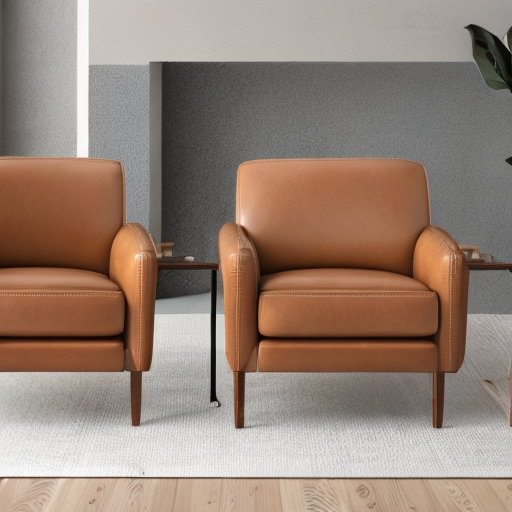

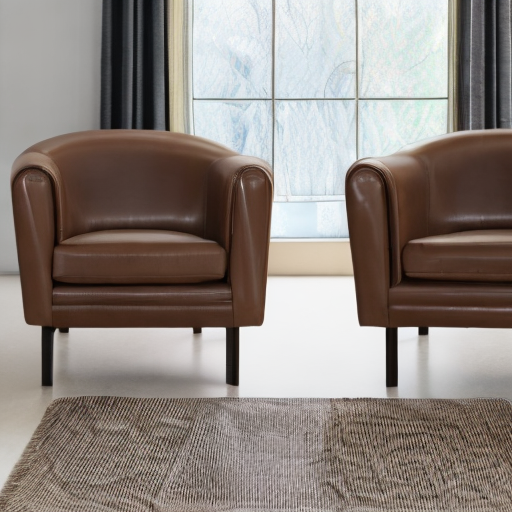

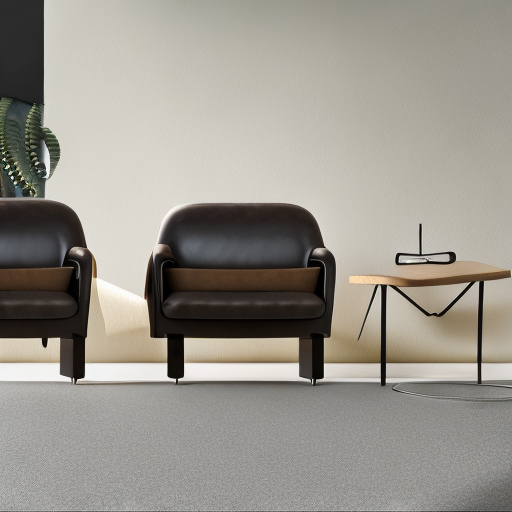

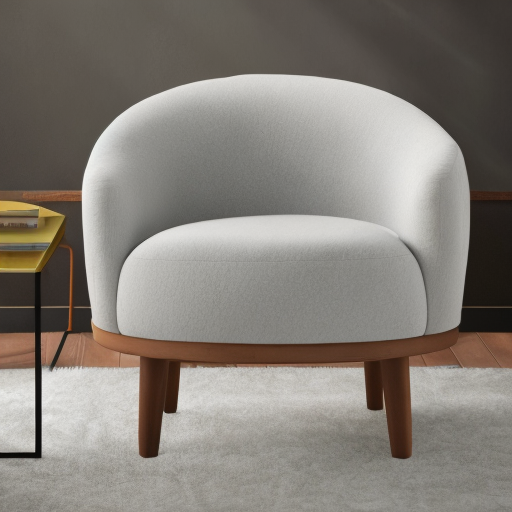

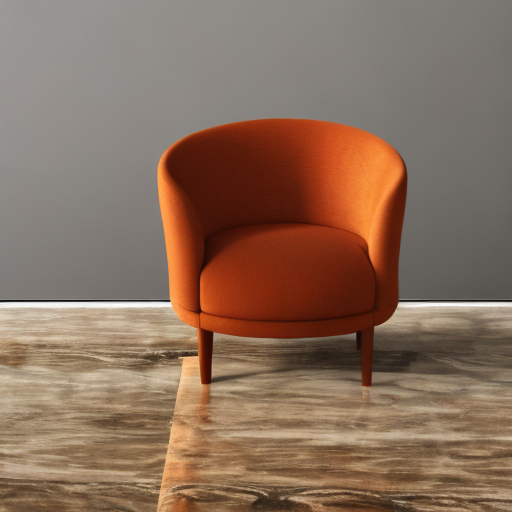

...

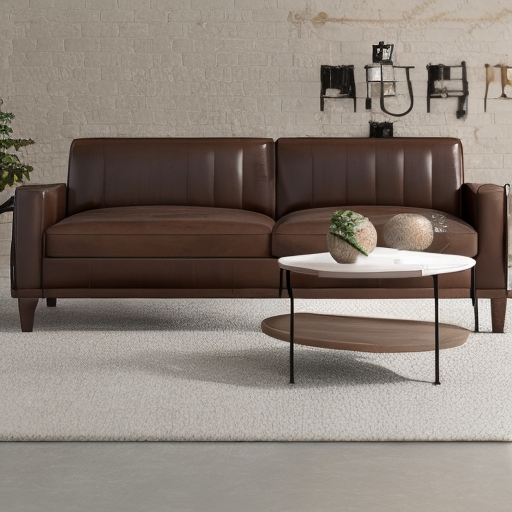

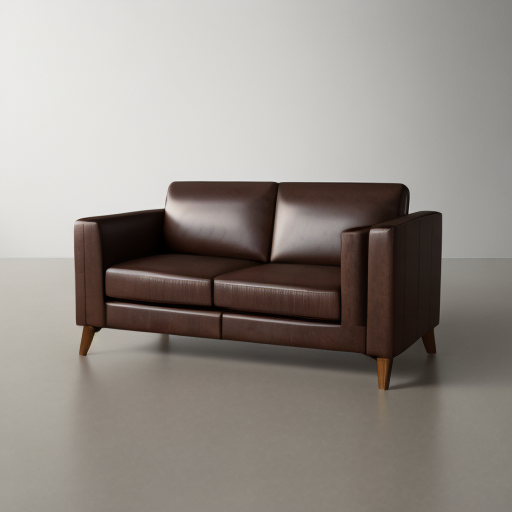

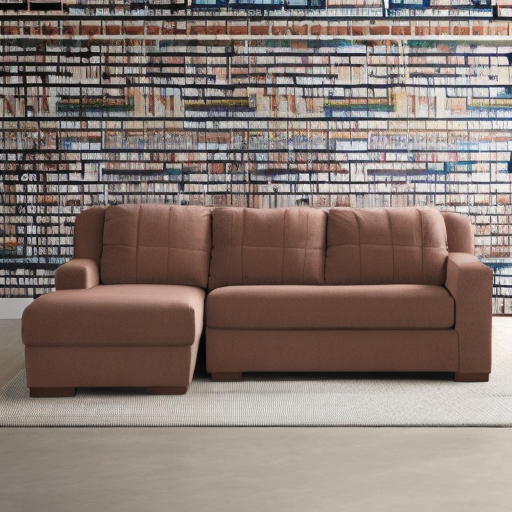

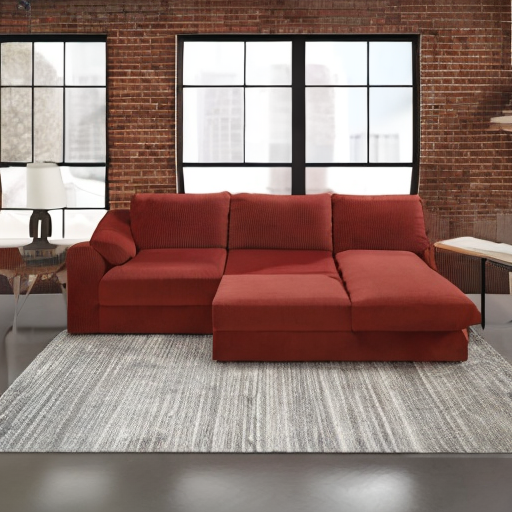

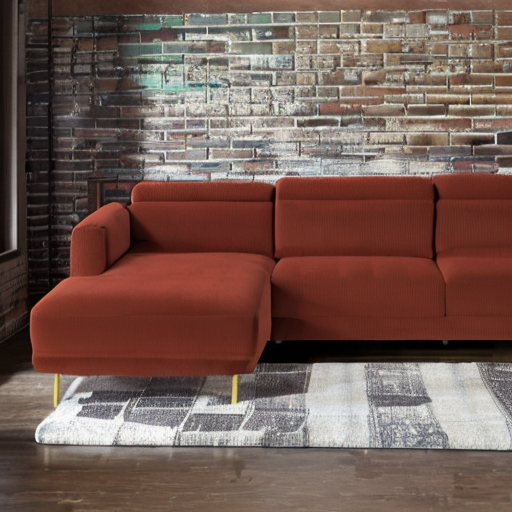

In [ ]:
#@title Test generation
import numpy as np

guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
num_samples = 3 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}

with autocast('cuda'), torch.inference_mode():
    images_pil = pipe(
        prompts,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images


images_np = np.array([np.array(img) for img in images_pil])
for img in images_pil:
    display(img)

In [ ]:
#@title VILA Mean Option Score (higher is better)
import tensorflow as tf
import tensorflow_hub as hub

import requests
from PIL import Image
from io import BytesIO

import matplotlib.pyplot as plt
import numpy as np
import cv2

model_handle = 'https://tfhub.dev/google/vila/image/1'
model = hub.load(model_handle)
predict_fn = model.signatures['serving_default']

mos_scores = []
for img in images_np:
    bgr_img = img[:, :, ::-1]
    png_bytes = cv2.imencode('.png', bgr_img)[1].tobytes()
    prediction = predict_fn(tf.constant(png_bytes))
    mos_scores.append(prediction['predictions'][0, 0].numpy())
np.mean(mos_scores)

0.5143854

In [ ]:
#@title CLIP Score (higher is better)
from torchmetrics.functional.multimodal import clip_score

clip_score = clip_score(
    torch.from_numpy(images_np).permute(0, 3, 1, 2),
    np.repeat(prompts, num_samples).tolist(),
    model_name_or_path='laion/CLIP-ViT-H-14-laion2B-s32B-b79K'
)
float(clip_score)

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


32.473182678222656

In [ ]:
#@title Fréchet Inception Distance (FID) (lower is better)
from torchmetrics.image.fid import FrechetInceptionDistance
from torchvision.transforms import functional as F
from PIL import Image
from pathlib import Path


def preprocess_image(image):
    image = torch.tensor(image).unsqueeze(0)
    image = image.permute(0, 3, 1, 2)
    return F.resize(image, (256, 256))


fids = []
for i, instance_path_str in enumerate(real_image_paths):
    real_images = [np.array(Image.open(path).convert('RGB')) for path in Path(instance_path_str).iterdir()]
    real_images = torch.cat([preprocess_image(image) for image in real_images])
    fake_images = torch.cat([preprocess_image(image) for image in images_np[i * num_samples:(i + 1) * num_samples]])
    fid = FrechetInceptionDistance()
    fid.update(real_images, real=True)
    fid.update(fake_images, real=False)
    fids.append(float(fid.compute()))
np.mean(fids)

289.1153137207031

In [ ]:
#@title Inference generation

prompt = "a living room" #@param {type:"string"}
negative_prompt = "" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

In [ ]:
# @title Upload model
hf_token = '' #@param {type:"string"}
repo_id = 'Arkan0ID/furniture-model-sd-2-1-5000'

from huggingface_hub import HfApi, HfFolder, CommitOperationAdd
from huggingface_hub import create_repo

create_repo(repo_id, private=True, token=hf_token)
api = HfApi()
api.upload_folder(
    folder_path='/content/stable_diffusion_weights/zwx/5000',
    repo_id=repo_id,
    token=hf_token
)

Upload 3 LFS files:   0%|          | 0/3 [00:00<?, ?it/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

'https://huggingface.co/Arkan0ID/furniture-model-sd-2-1-5000/tree/main/'

In [ ]:
#@markdown Run to generate a grid of preview images from the last saved weights.
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

weights_folder = OUTPUT_DIR
folders = sorted([f for f in os.listdir(weights_folder) if f != "0"], key=lambda x: int(x))

row = len(folders)
col = len(os.listdir(os.path.join(weights_folder, folders[0], "samples")))
scale = 4
fig, axes = plt.subplots(row, col, figsize=(col*scale, row*scale), gridspec_kw={'hspace': 0, 'wspace': 0})

for i, folder in enumerate(folders):
    folder_path = os.path.join(weights_folder, folder)
    image_folder = os.path.join(folder_path, "samples")
    images = [f for f in os.listdir(image_folder)]
    for j, image in enumerate(images):
        if row == 1:
            currAxes = axes[j]
        else:
            currAxes = axes[i, j]
        if i == 0:
            currAxes.set_title(f"Image {j}")
        if j == 0:
            currAxes.text(-0.1, 0.5, folder, rotation=0, va='center', ha='center', transform=currAxes.transAxes)
        image_path = os.path.join(image_folder, image)
        img = mpimg.imread(image_path)
        currAxes.imshow(img, cmap='gray')
        currAxes.axis('off')

plt.tight_layout()
plt.savefig('grid.png', dpi=300)

In [ ]:
#@markdown Run Gradio UI for generating images.
import gradio as gr

def inference(prompt, negative_prompt, num_samples, height=512, width=512, num_inference_steps=50, guidance_scale=7.5):
    with torch.autocast("cuda"), torch.inference_mode():
        return pipe(
                prompt, height=int(height), width=int(width),
                negative_prompt=negative_prompt,
                num_images_per_prompt=int(num_samples),
                num_inference_steps=int(num_inference_steps), guidance_scale=guidance_scale,
                generator=g_cuda
            ).images

with gr.Blocks() as demo:
    with gr.Row():
        with gr.Column():
            prompt = gr.Textbox(label="Prompt", value="photo of zwx dog in a bucket")
            negative_prompt = gr.Textbox(label="Negative Prompt", value="")
            run = gr.Button(value="Generate")
            with gr.Row():
                num_samples = gr.Number(label="Number of Samples", value=4)
                guidance_scale = gr.Number(label="Guidance Scale", value=7.5)
            with gr.Row():
                height = gr.Number(label="Height", value=512)
                width = gr.Number(label="Width", value=512)
            num_inference_steps = gr.Slider(label="Steps", value=24)
        with gr.Column():
            gallery = gr.Gallery()

    run.click(inference, inputs=[prompt, negative_prompt, num_samples, height, width, num_inference_steps, guidance_scale], outputs=gallery)

demo.launch(debug=True)

## Convert weights to ckpt to use in web UIs like AUTOMATIC1111.

In [ ]:
#@markdown Run conversion.
ckpt_path = WEIGHTS_DIR + "/model.ckpt"

half_arg = ""
#@markdown  Whether to convert to fp16, takes half the space (2GB).
fp16 = True #@param {type: "boolean"}
if fp16:
    half_arg = "--half"
!python convert_diffusers_to_original_stable_diffusion.py --model_path $WEIGHTS_DIR  --checkpoint_path $ckpt_path $half_arg
print(f"[*] Converted ckpt saved at {ckpt_path}")

In [ ]:
#@title (Optional) Delete diffuser and old weights and only keep the ckpt to free up drive space.

#@markdown [ ! ] Caution, Only execute if you are sure u want to delete the diffuser format weights and only use the ckpt.
import shutil
from glob import glob
import os
for f in glob(OUTPUT_DIR+os.sep+"*"):
    if f != WEIGHTS_DIR:
        shutil.rmtree(f)
        print("Deleted", f)
for f in glob(WEIGHTS_DIR+"/*"):
    if not f.endswith(".ckpt") or not f.endswith(".json"):
        try:
            shutil.rmtree(f)
        except NotADirectoryError:
            continue
        print("Deleted", f)